# Motion in 2D

```{index}Motion in 2D

In [1]:
import numpy as np
%matplotlib inline
import matplotlib.pyplot as plt
from matplotlib import animation, rc
from IPython.display import HTML

## Tutorial Problem 2.1, 2.2

Projectile motion

In [9]:
def get_xy(a, v0, start, end, interval):
    angle = a * 2 * np.pi / 360
    t = np.arange(start, end, interval)
    # x(t) = vcos(angle)*t
    x = v0 * np.cos(angle) * t
    # y(t) = vsin(angle)*t - 1/2 gt**2
    y = v0 * np.sin(angle) * t - 0.5 * 9.81 * t**2  
    return x, y

X1, Y1 = get_xy(53.1, 37, 0, 6.04, 0.01)

X2, Y2 = get_xy(89, 200, 0, 40.8, 0.1)

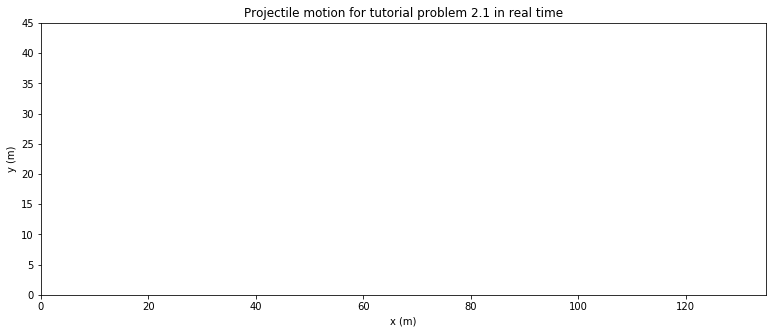

In [10]:
nframes = len(X1)


fig, ax = plt.subplots(figsize=(13,5))

ax.set_xlim((0, 135))
ax.set_ylim((0, 45))
ax.set_xlabel('x (m)')
ax.set_ylabel('y (m)')
ax.set_title('Projectile motion for tutorial problem 2.1 in real time')

line, = ax.plot([], [], 'ro', lw=2)

def init():
    line.set_data([], [])
    return (line,)

def animate(i):
    x = X1[i]
    y = Y1[i]
    line.set_data(x, y)
    return (line,)

anim = animation.FuncAnimation(fig, animate, init_func=init,
                               frames=nframes, interval=10, 
                               blit=True)

In [11]:
HTML(anim.to_jshtml())

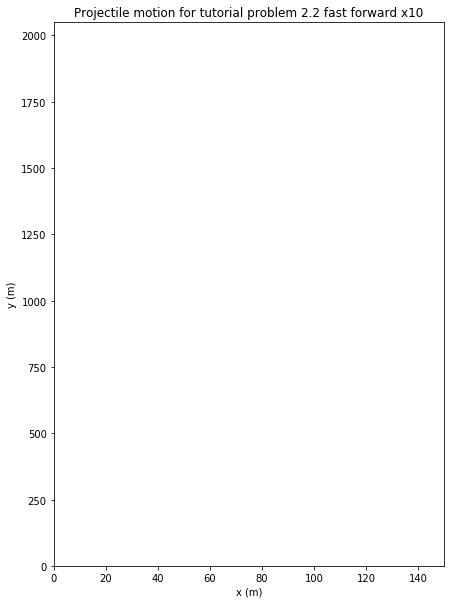

In [12]:
nframes = len(X2)


fig, ax = plt.subplots(figsize=(7,10))

ax.set_xlim((0, 150))
ax.set_ylim((0, 2050))
ax.set_xlabel('x (m)')
ax.set_ylabel('y (m)')
ax.set_title('Projectile motion for tutorial problem 2.2 fast forward x10')

line, = ax.plot([], [], 'bo', lw=2)

def init():
    line.set_data([], [])
    return (line,)

def animate(i):
    x = X2[i]
    y = Y2[i]
    line.set_data(x, y)
    return (line,)

anim = animation.FuncAnimation(fig, animate, init_func=init,
                               frames=nframes, interval=10, 
                               blit=True)

In [13]:
HTML(anim.to_jshtml())

## Tutorial Problem 2.3

Rock sliding down a slope

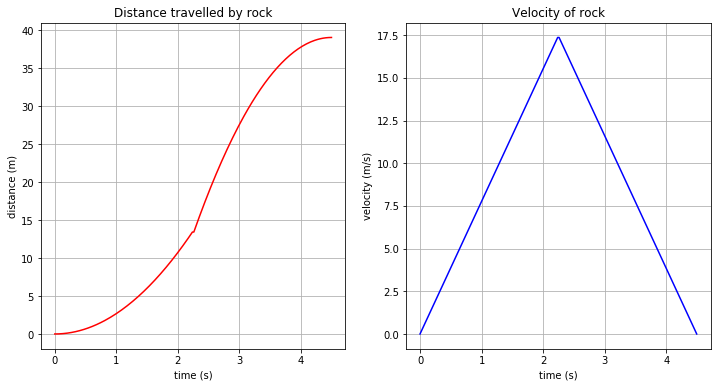

In [43]:
u = 0.6
a = 40
H = 10
g = 9.81

x = np.zeros(200)

v = np.zeros(200)

t_bottom = np.sqrt((2*H)/(g*(np.sin(a)-u*np.cos(a))*np.sin(a)))

t1 = np.linspace(0, t_bottom, 100)

x[:100] = g * (np.sin(a)-u*np.cos(a))*t1**2/2

v[:100] = g * (np.sin(a)-u*np.cos(a))*t1

t_stop = v[99]/(u*g)

t2 = np.linspace(0, t_stop, 100)

x[100:] = x[99] + v[99]*t2 - 0.5*u*g*t2**2

v[100:] = v1[-1] - u*g*t2

t = np.linspace(0, t_bottom+t_stop, 200)

fig = plt.figure(figsize=(12, 6))

ax1 = fig.add_subplot(121)
ax1.plot(t, x, 'r')
ax1.set_xlabel('time (s)')
ax1.set_ylabel('distance (m)')
ax1.set_title('Distance travelled by rock')
ax1.grid(True)


ax2 = fig.add_subplot(122)
ax2.plot(t, v, 'b')
ax2.set_xlabel('time (s)')
ax2.set_ylabel('velocity (m/s)')
ax2.set_title('Velocity of rock')
ax2.grid(True)

plt.show()

## Tutorial Problem 2.4

Optimum angle to move a block of mass

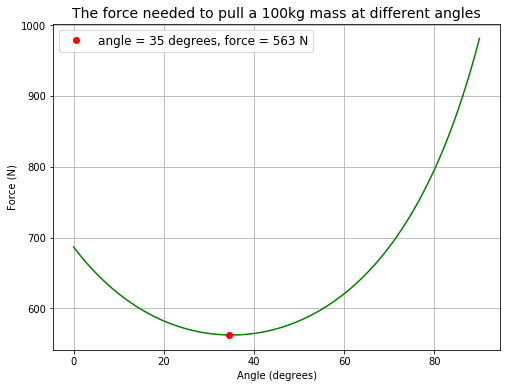

In [8]:
# plug in random numbers
u = 0.7
m = 100 #kg
g = 9.81 #m/s2

alpha = np.linspace(0, 0.5*np.pi, 100)

F = (u*m*g)/(np.cos(alpha)+u*np.sin(alpha))
    
alpha = alpha*360/(2*np.pi)

minimum = np.where(F == min(F))[0][0]

fig = plt.figure(figsize=(8,6))    
plt.plot(alpha, F, 'g')
plt.plot(alpha[minimum], F[minimum], 'ro', label='angle = %.f degrees, force = %.f N' % (alpha[minimum], F[minimum]))
plt.xlabel('Angle (degrees)')
plt.ylabel('Force (N)')
plt.title('The force needed to pull a 100kg mass at different angles', fontsize=14)
plt.grid(True)
plt.legend(loc='upper left', fontsize=12)

plt.show()

## Tutorial Problem 2.6

Radial and angular velocity and acceleration during radial and circular motion

In [44]:
angles = np.linspace(0, 2*np.pi, 201)

drdt = np.ones(len(angles)) # Speed at which ant is travelling out of centre of wheel
drdt = 0.5 * drdt # 0.5 m/s

t = np.linspace(0, 2, len(angles))

r = drdt * t

w = np.pi # angular velocity

print("Period = %.f s" % (2*np.pi/w))

# angular velocity
v_r = drdt # radial coordinate
v_a = r * w # angle coordinate

# acceleration
a_r = -w**2 * r # radial coordinate
a_a = 2 * w * drdt # angle coordinate

Period = 2 s


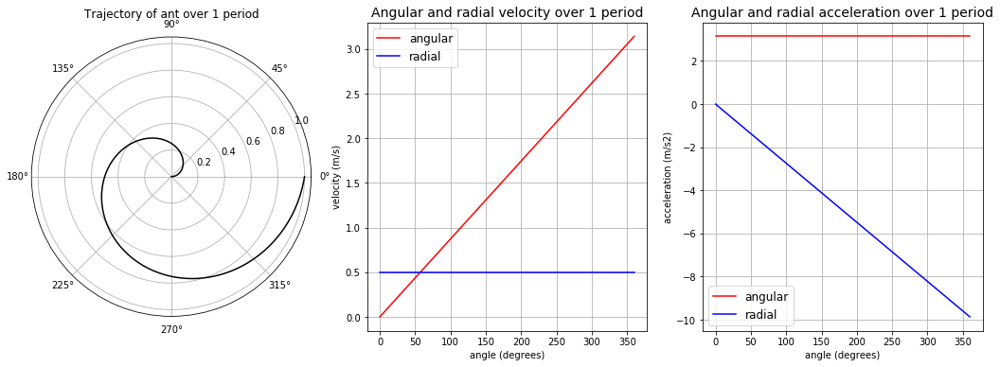

In [45]:
fig = plt.figure(figsize=(18, 6))

ax1 = fig.add_subplot(131, projection='polar')
ax1.plot(angles, r, 'k')
ax1.set_title('Trajectory of ant over 1 period')

angles = angles * 360 / (2 * np.pi)

ax2 = fig.add_subplot(132)
ax2.plot(angles, v_a, 'r', label='angular')
ax2.plot(angles, v_r, 'b', label='radial')
ax2.set_xlabel('angle (degrees)')
ax2.set_ylabel('velocity (m/s)')
ax2.set_title('Angular and radial velocity over 1 period', fontsize=14)
ax2.legend(loc='best', fontsize=12)
ax2.grid(True)

ax3 = fig.add_subplot(133)
ax3.plot(angles, a_a, 'r', label='angular')
ax3.plot(angles, a_r, 'b', label='radial')
ax3.set_xlabel('angle (degrees)')
ax3.set_ylabel('acceleration (m/s2)')
ax3.set_title('Angular and radial acceleration over 1 period', fontsize=14)
ax3.legend(loc='best', fontsize=12)
ax3.grid(True)

plt.show()

## Tutorial Problem 2.7

Angular velocity and tension in string of a simple pendulum

In [3]:
g = 9.81
# plug in simple numbers
l = 1
m = 1

wn = np.sqrt(g/l)

t = np.linspace(0, 2*np.pi/wn, 100)

# sub into function derived
angle = np.cos(wn*t)

# convert to x and y coordinates
X = np.sin(angle) 
Y = 1 - np.cos(angle)

# angular velocity over time
w = -wn * np.sin(wn*t)

# tension over time
T = m * g + m * w**2 * l

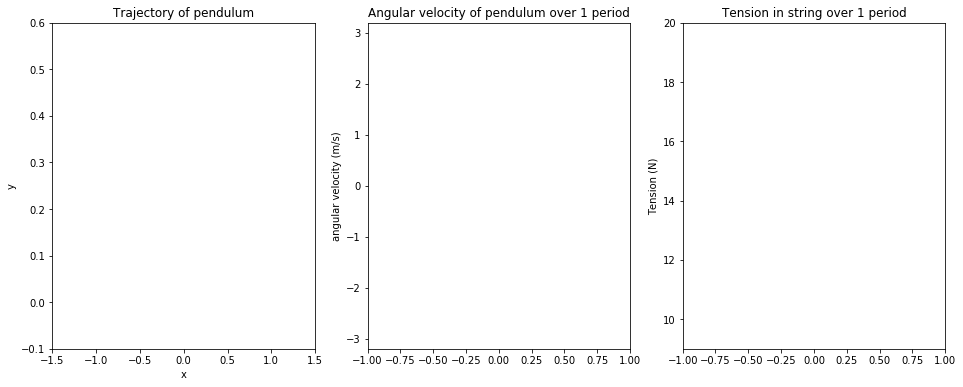

In [6]:
nframes = len(t)


# Plot background axes
fig, axes = plt.subplots(1,3, figsize=(16,6))

# define lines
line1, = axes[0].plot([], [], 'ro', lw=2)
line2, = axes[0].plot([], [], 'k')
line3, = axes[1].plot([], [], 'go', lw=2)
line4, = axes[2].plot([], [], 'bo', lw=2)

# customise axes 

axes[0].set_xlim((-1.5, 1.5))
axes[0].set_ylim((-0.1, 0.6))
axes[0].set_xlabel('x')
axes[0].set_ylabel('y')
axes[0].set_title('Trajectory of pendulum')


axes[1].set_xlim((-1, 1))
axes[1].set_ylim((-3.2, 3.2))
axes[1].set_ylabel('angular velocity (m/s)')
axes[1].set_title('Angular velocity of pendulum over 1 period')


axes[2].set_xlim((-1, 1))
axes[2].set_ylim((9, 20))
axes[2].set_ylabel('Tension (N)')
axes[2].set_title('Tension in string over 1 period')

    
lines = [line1, line2, line3, line4]

# Plot background for each frame
def init():
    for line in lines:
        line.set_data([], [])
    return lines

# Set what data to plot in each frame
def animate(i):
    
    x1 = X[i]
    y1 = Y[i]
    lines[0].set_data(x1, y1)
    x_1 = X
    y_1 = Y
    lines[1].set_data(x_1, y_1)
    
    x2 = 0
    y2 = w[i]
    lines[2].set_data(x2, y2)
    
    x3 = 0
    y3 = T[i]
    lines[3].set_data(x3, y3)

    
    return lines

# Call the animator
anim = animation.FuncAnimation(fig, animate, init_func=init,
                               frames=nframes, interval=40, blit=True)

In [7]:
HTML(anim.to_html5_video())